<a href="https://colab.research.google.com/github/SsayanJ/object-detection/blob/main/object_detection_plastic_cups.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

Welcome to a tutorial on how to train your custom dataset on the TF2 Object Detection API.

If you are looking for a model which draws bounding boxes around objects, then you have come to the right place.

This tutorial is completely contained in a single Colab notebook, so there is no need to run any code on your computer.

The main steps of the tutorial:
1. Install the Object Detection API and other dependencies
2. Load your data from Google Drive
3. Convert the data into TFRecord files.
4. Train the model.

# References

This tutorial has been heavily copied from the following awesome guides:
- [Tensorflow Object Detection API Tutorial](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/)
- [Official Tensorflow Object Detection API Guides](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2.md)
- [TF1 Object Detection Training on GCP](https://colab.research.google.com/github/cloud-annotations/google-colab-training/blob/master/object_detection.ipynb)

# Install the environment

Python 3.6 and Tensorflow 2.3 should work for this to work.

In [ ]:
!python --version

Python 3.7.10


In [ ]:
import tensorflow as tf
print(tf.__version__)

2.5.0


## Setting directory locations

In [ ]:
MODELS_DIR = "/content/models"
OBJ_DET_DIR = "/content/models/research/object_detection"

## Cloning from github

Following the [official guide](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2.md) to install.

In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 58204, done.
remote: Total 58204 (delta 0), reused 0 (delta 0), pack-reused 58204
Receiving objects: 100% (58204/58204), 572.91 MiB | 38.03 MiB/s, done.
Resolving deltas: 100% (40409/40409), done.


In [ ]:
%%bash
cd models/research
# Compile protos.
protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1652954 sha256=48116a371ee3e3aecc10998777174ac15cff1ac1c2dd04c3672649246ceae2dc
  Stored in directory: /tmp/pip-ephem-wheel-cache-l0277az7/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
  Created wheel for avro-python3: filename=avro_python3-1.10.2-cp37-none-any.whl size=44011 sha256=45fbdfa2f1008c703c6bca0dc35c2ee6b30667714b16d53eaabdabea7ac429b1
  Stored in directory: /root/.cache/pip/wheels/ee/ee/18/c466221ca6900e3efce2f4ea9c329288808679aecdcb2838d3
  Created wheel for dill: filename=dill-0.3.1.1-cp37-none-any.whl size=78545 sha256=7096ae3c5b241e70f92b923fad116ba5869b81f6801d0346c659a2d24139744b
  Stored in directory: /root/.cache/pip/wheels/59/b1/91/f02e76c732915c4015ab4010f3015469866c1eb9b14058d8e7
  Created wheel for future: filename=future-0.18.2-cp37-none-any.whl size=491070 sha256=01fe5ded5a69c24bd43728fa3c2fe453685b11572d4c4e5f1da9

ERROR: multiprocess 0.70.11.1 has requirement dill>=0.3.3, but you'll have dill 0.3.1.1 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.25.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: apache-beam 2.30.0 has requirement avro-python3!=1.9.2,<1.10.0,>=1.8.1, but you'll have avro-python3 1.10.2 which is incompatible.


## Adding paths to environment variables

In [ ]:
import os

main_dir = "/content"
os.environ['PYTHONPATH'] += f':{main_dir}:{main_dir}/slim'
os.environ['PYTHONPATH'] += f':{main_dir}:{main_dir}/models'
os.environ['PYTHONPATH'] += f':{main_dir}:{main_dir}/models/research'

## Testing the installation

In [ ]:
!python "$OBJ_DET_DIR/builders/model_builder_tf2_test.py"

2021-06-11 11:33:11.806875: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-06-11 11:33:14.102324: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-06-11 11:33:14.158071: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-06-11 11:33:14.158704: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-06-11 11:33:14.158746: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfull

There will be a really long output.

But if the installation succeeded, you should see something like this at the bottom:

```
----------------------------------------------------------------------
Ran 20 tests in 45.495s

OK (skipped=1)
```

# Data

## How to label your data

Your data must be either JPG or PNG format images, and the annotations must be in [PASCAL VOC XML format](https://gist.github.com/Prasad9/30900b0ef1375cc7385f4d85135fdb44).

The best way to annotate for this tutorial is to follow [this tutorial](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html#annotate-the-dataset), which uses [LabelImg](https://github.com/tzutalin/labelImg) to annotate the images.


<img src="https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/_images/labelImg.JPG" height=300px>

<small>LabelImg</small>

Once you have the data, upload it to Google Drive and paste the directory path in the `G_DRIVE_PATH` below.

The data folder must contain all the images and XML files in it, like this:
```
1.jpg
1.xml
2.jpg
2.xml
...
```
Make sure the names of the images and XML files are the same. The names don't have to be numbers, they can be anything.

## Copying your data to colab

In [ ]:
# Paste your path here.
G_DRIVE_PATH = '/content/drive/MyDrive/Evolutek_CV/dataset_04062021'
G_DRIVE_PATH = '/content/drive/MyDrive/Evolutek_CV/dataset_06062021'

Mount Google Drive.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Your images and XML files will be copied to `DATA_DIR`.

In [ ]:
DATA_DIR = "/content/data"

!mkdir "$DATA_DIR"

Check to see if Google Drive contains your data:

In [ ]:
import glob
from pprint import pprint

images_paths = glob.glob(G_DRIVE_PATH + "/images/train/*.jpg")
images_paths = sorted(images_paths)

pprint(images_paths[:10])

['/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_00.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_01.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_010.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_011.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_012.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_014.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_015.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_016.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_017.jpg',
 '/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train/result_018.jpg']


In [ ]:
print(len(images_paths))

55


## Train-Validation Split

The train data receives 90% by default, but you can change `TRAIN_SPLIT` to something like 80 or 95.

In [ ]:
from random import shuffle

TRAIN_SPLIT = 90

limit = int(len(images_paths) * TRAIN_SPLIT / 100)

shuffle(images_paths)
train_images = images_paths[:limit]
val_images = images_paths[limit:]

print("Number of train images:", len(train_images))
print("Number of validation images:", len(val_images))

Number of train images: 49
Number of validation images: 6


The train images and annotations will be copied to `/content/data/train` and the validation ones to `/content/data/val`.

In [ ]:
from IPython.display import display, clear_output
from shutil import copyfile
import os

TRAIN_DATA_DIR = os.path.join(DATA_DIR, "train")
VAL_DATA_DIR = os.path.join(DATA_DIR, "val")

!mkdir $TRAIN_DATA_DIR
!mkdir $VAL_DATA_DIR

for i, img_path in enumerate(train_images):
  img_name = img_path.split("/")[-1]
  xml_path = img_path.replace(".png", ".xml")
  xml_name = img_name.replace(".png", ".xml")

  if i%100 == 0:
    clear_output(wait=True)
    display("Copying {} out of {} files.".format(i, len(train_images)))

  destination = TRAIN_DATA_DIR

  copyfile(img_path,
           os.path.join(destination, img_name))
  copyfile(xml_path,
           os.path.join(destination, xml_name))
  
print("Successfully copied train data to {}".format(TRAIN_DATA_DIR))

for i, img_path in enumerate(val_images):
  img_name = img_path.split("/")[-1]
  xml_path = img_path.replace(".png", ".xml")
  xml_name = img_name.replace(".png", ".xml")

  if i%100 == 0:
    clear_output(wait=True)
    display("Copying {} out of {} files.".format(i, len(val_images)))

  destination = VAL_DATA_DIR

  copyfile(img_path,
           os.path.join(destination, img_name))
  copyfile(xml_path,
           os.path.join(destination, xml_name))
  
print("Successfully copied validation data to {}".format(VAL_DATA_DIR))

In [ ]:
# !cp -r /content/drive/MyDrive/Evolutek_CV/dataset_04062021/images/test /content/data/
# !cp -r /content/drive/MyDrive/Evolutek_CV/dataset_04062021/images/train /content/data/

!cp -r /content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/test /content/data/
!cp -r /content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/train /content/data/

Test to see if the files were copied properly:

In [ ]:
TRAIN_DATA_DIR = '/content/data/train'
VAL_DATA_DIR = '/content/data/test'

In [ ]:
print("# images in train dir:", len(glob.glob(TRAIN_DATA_DIR + "/*.jpg")))
print("# XML in train dir:", len(glob.glob(TRAIN_DATA_DIR + "/*.xml")))
print("# images in validation dir:", len(glob.glob(VAL_DATA_DIR + "/*.jpg")))
print("# XML in train dir:", len(glob.glob(VAL_DATA_DIR + "/*.xml")))

# images in train dir: 55
# XML in train dir: 27
# images in validation dir: 5
# XML in train dir: 5


# Generate TFRecords

Now that all the data has been copied to colab, it must be converted to TFRecords format, because the Object Detection API uses it. You can read more about the record format online.

I adapted this [official script](https://github.com/tensorflow/models/blob/master/research/object_detection/dataset_tools/create_pascal_tf_record.py) and created a github [gist](https://gist.github.com/yasserius/ef9eb79c3f2f516ed1e4f793150d6f76), which is what is being used in the following steps.

The `train.record` and `val.record` files will be stored in the `/content/data` directory.

In [ ]:
TRAIN_TFRECORD_PATH = os.path.join(DATA_DIR, "train.record")
VAL_TFRECORD_PATH = os.path.join(DATA_DIR, "val.record")

Downloading the gist as a file named `tfrecord_generator.py`.

In [ ]:
!wget https://gist.githubusercontent.com/yasserius/ef9eb79c3f2f516ed1e4f793150d6f76/raw/20cee1a342d79e24b649a7b3dbc9500be832ce6f/tfrecord_generator.py

--2021-06-11 11:36:58--  https://gist.githubusercontent.com/yasserius/ef9eb79c3f2f516ed1e4f793150d6f76/raw/20cee1a342d79e24b649a7b3dbc9500be832ce6f/tfrecord_generator.py
Resolving gist.githubusercontent.com (gist.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to gist.githubusercontent.com (gist.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6460 (6.3K) [text/plain]
Saving to: ‘tfrecord_generator.py’

tfrecord_generator. 100%[===================>]   6.31K  --.-KB/s    in 0s      

2021-06-11 11:36:58 (86.5 MB/s) - ‘tfrecord_generator.py’ saved [6460/6460]



The script does two things:
1. It generates a `label_map.pbtxt` file, which contains all the class names and their indices.
2. It generates `train.record` and `val.record` using the image and XML files.

## Generating label map file

In [ ]:
from tfrecord_generator import create_tfrecords, generate_label_map

LABEL_MAP_PATH = os.path.join(DATA_DIR, "label_map.pbtxt")

label_map_dict = generate_label_map(TRAIN_DATA_DIR, output_path=LABEL_MAP_PATH)

print(label_map_dict)

Successfully created /content/data/label_map.pbtxt
{'green_cup': 1, 'red_cup': 2}


/usr/local/lib/python3.7/dist-packages/object_detection/utils/dataset_util.py:83: FutureWarning: The behavior of this method will change in future versions. Use specific 'len(elem)' or 'elem is not None' test instead.
  if not xml:


## Generating TFRecord files

In [ ]:
create_tfrecords(TRAIN_DATA_DIR,
                 output_path=TRAIN_TFRECORD_PATH,
                 label_map_dict=label_map_dict)

create_tfrecords(VAL_DATA_DIR,
                 output_path=VAL_TFRECORD_PATH,
                 label_map_dict=label_map_dict)

/usr/local/lib/python3.7/dist-packages/object_detection/utils/dataset_util.py:83: FutureWarning: The behavior of this method will change in future versions. Use specific 'len(elem)' or 'elem is not None' test instead.
  if not xml:


Check the size of the record files to check if the files are proper. The sizes are shown in bytes, and should be close to your raw data size.

In [ ]:
!stat -c%s "$TRAIN_TFRECORD_PATH"

8096379


In [ ]:
!stat -c%s "$VAL_TFRECORD_PATH"

1505552


## (Optional) copy record files to google drive

Since colab will lose the record files with the session, it is best that copy them back into drive.

In [ ]:
!cp "$TRAIN_TFRECORD_PATH" "$G_DRIVE_PATH"
!cp "$VAL_TFRECORD_PATH" "$G_DRIVE_PATH"

# Download pretrained model

## Paste the link to pretrained mdoel

You must choose a pretrained model from [TF2 Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md).

Then paste the link to the tar file below:

In [ ]:
MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz'
MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d1_coco17_tpu-32.tar.gz'


## Downloading to checkpoint directory

The downlaoded model will be in `/content/pretrained`.

In [ ]:
CHECKPOINT_DIR = "/content/pretrained"

filename = MODEL_URL.split('/')[-1]

!mkdir "$CHECKPOINT_DIR"
!wget $MODEL_URL
!tar -xzvf "$filename" -C "$CHECKPOINT_DIR"

mkdir: cannot create directory ‘/content/pretrained’: File exists
--2021-06-11 11:38:38--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d1_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.253.63.128, 2607:f8b0:4004:c08::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.253.63.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51839363 (49M) [application/x-tar]
Saving to: ‘efficientdet_d1_coco17_tpu-32.tar.gz’

efficientdet_d1_coc 100%[===================>]  49.44M   158MB/s    in 0.3s    

2021-06-11 11:38:39 (158 MB/s) - ‘efficientdet_d1_coco17_tpu-32.tar.gz’ saved [51839363/51839363]

efficientdet_d1_coco17_tpu-32/
efficientdet_d1_coco17_tpu-32/checkpoint/
efficientdet_d1_coco17_tpu-32/checkpoint/ckpt-0.data-00000-of-00001
efficientdet_d1_coco17_tpu-32/checkpoint/checkpoint
efficientdet_d1_coco17_tpu-32/checkpoint/ckpt-0.index
efficientdet_d1_coco17_tpu-32/pipelin

The following files are needed for our training:
1. `ckpt-0`
2. `pipeline.config`

This program gets them and stores them in `PIPELINE_TEMPLATE_PATH` and `CKPT_PATH`.

In [ ]:
import os

PIPELINE_TEMPLATE_PATH = None
CKPT_PATH = None

for dir, subdirs, files in os.walk(CHECKPOINT_DIR):
  if "pipeline.config" in files:
    PIPELINE_TEMPLATE_PATH = os.path.join(dir, "pipeline.config")
    print(PIPELINE_TEMPLATE_PATH)
  elif "ckpt-0.data-00000-of-00001" in files:
    CKPT_PATH = os.path.join(dir, "ckpt-0")
    # CKPT_PATH = os.path.join(dir, "ckpt-0.data-00000-of-00001")
    print(CKPT_PATH)

/content/pretrained/efficientdet_d1_coco17_tpu-32/pipeline.config
/content/pretrained/efficientdet_d1_coco17_tpu-32/checkpoint/ckpt-0
/content/pretrained/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/pipeline.config
/content/pretrained/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0


# Editing configuration file

The `pipeline.config` file is very important, since it contains all the trianing parameters and paths to all the record files.

The following program edits that.

You can increase or decrease the batch size. If you have small images like MNIST, use 32. But if each image is large like 1000x1000, then use 2 or 4.

In [ ]:
BATCH_SIZE = 2

In [ ]:
import re

from google.protobuf import text_format

from object_detection.utils import config_util
from object_detection.utils import label_map_util

configs = config_util.get_configs_from_pipeline_file(PIPELINE_TEMPLATE_PATH)

label_map = label_map_util.get_label_map_dict(LABEL_MAP_PATH)
num_classes = len(label_map.keys())
meta_arch = configs["model"].WhichOneof("model")

override_dict = {
  'model.{}.num_classes'.format(meta_arch): num_classes,
  'train_config.batch_size': BATCH_SIZE,
  'train_input_path': TRAIN_TFRECORD_PATH,
  'eval_input_path': VAL_TFRECORD_PATH,
  'train_config.fine_tune_checkpoint': CKPT_PATH,
  'train_config.fine_tune_checkpoint_type': "detection",
  'label_map_path': LABEL_MAP_PATH
}

configs = config_util.merge_external_params_with_configs(configs, kwargs_dict=override_dict)
pipeline_config = config_util.create_pipeline_proto_from_configs(configs)
config_util.save_pipeline_config(pipeline_config, DATA_DIR)

print("Successfully created configuration file.")

INFO:tensorflow:Maybe overwriting model.ssd.num_classes: 2
INFO:tensorflow:Maybe overwriting train_config.batch_size: 2
INFO:tensorflow:Maybe overwriting train_input_path: /content/data/train.record
INFO:tensorflow:Maybe overwriting eval_input_path: /content/data/val.record
INFO:tensorflow:Maybe overwriting train_config.fine_tune_checkpoint: /content/pretrained/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0
INFO:tensorflow:Maybe overwriting train_config.fine_tune_checkpoint_type: detection
INFO:tensorflow:Maybe overwriting label_map_path: /content/data/label_map.pbtxt
INFO:tensorflow:Writing pipeline config file to /content/data/pipeline.config
Successfully created configuration file.


You can view the final file from the left panel at `/content/data/pipeline.config`. 

If you are more interested, you can read these links too: [1](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/configuring_jobs.md), [2](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html#configure-the-training-pipeline)


# Training

Finally, your model is ready to train.

The checkpoints (`ckpt` weight files) at different stages of the training will be stored in `OUTPUT_PATH`.

Since colab is not super reliable and often disconnects, it might be the case that you lose your trained checkpoints. So, it is best that you store the checkpoints in drive.

In [ ]:
OUTPUT_PATH = os.path.join(G_DRIVE_PATH, "training_oct_10")

# uncomment this is you want to store the checkpoints in colab
OUTPUT_PATH = "/content/training"

If you wish to monitor the training via colab, run the following cell.

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=$OUTPUT_PATH

<IPython.core.display.Javascript object>

Now begins the long process of training.

* You can tweak the `--checkpoint_every_n=100 ` to some other value. Use 200 or 300 if you want to store less checkpoints, and 10 or 50 if you want checkpoints more often.

* Keep in mind, colab will allow you a maximum of 12 hours of training.

* Also, paste this [javascript code](https://www.rockyourcode.com/script-to-stop-google-colab-from-disconnecting/) into the browser console to prevent colab from disconnecting.

* Finally, after you run the script, **it takes time to show the training process. BE PATIENT!**

* There will be a lot of warnings, no worries. And every 100 time steps later (which might be 1 or 2 hours), it will print the loss like this:
```
I1021 14:56:54.731037 140444534626176 model_lib_v2.py:652] Step 100 per-step time 64.361s loss=6.536
```

* To see detailed output of what is expected, see [this](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html#training-the-model).

Run the script!

In [ ]:
PIPELINE_CONFIG_PATH = "/content/data/pipeline.config"
TRAIN_FILE = "/content/models/research/object_detection/model_main_tf2.py"

!mkdir "$OUTPUT_PATH"

!python  $TRAIN_FILE \
    --alsologtostderr \
    --pipeline_config_path="$PIPELINE_CONFIG_PATH" \
    --model_dir="$OUTPUT_PATH" \
    --checkpoint_every_n=100 \

2021-06-11 11:40:08.135894: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-06-11 11:40:10.096355: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-06-11 11:40:10.126809: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-06-11 11:40:10.127412: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-06-11 11:40:10.127454: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-06-11 11:40:10.130466: I tensorflow/stream_executor/platform/default

# Export model

Once the loss decreases to about 0.1, you can stop training.

In [ ]:
EXPORT_DIR = os.path.join(G_DRIVE_PATH, "export")

!mkdir "$EXPORT_DIR"

!python "$OBJ_DET_DIR/exporter_main_v2.py" \
  --input_type='image_tensor' \
  --pipeline_config_path="$PIPELINE_CONFIG_PATH"  \
  --trained_checkpoint_dir="$OUTPUT_PATH" \
  --output_directory="$EXPORT_DIR"

2021-06-11 12:31:14.078196: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-06-11 12:31:17.918093: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-06-11 12:31:17.962950: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-06-11 12:31:17.963585: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-06-11 12:31:17.963637: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-06-11 12:31:17.981582: I tensorflow/stream_executor/platform/default

# Inference

In [ ]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
!pwd

/content


In [ ]:
# labelmap_path = f'/content/working_files/{DATASET}/label_map.pbtxt'
labelmap_path = "/content/drive/MyDrive/Evolutek_CV/dataset_04062021/label_map.pbtxt"
labelmap_path = "/content/drive/MyDrive/Evolutek_CV/dataset_06062021/label_map.pbtxt"
# output_directory =f'/working_files/{DATASET}/output_model/inference_graph'
# output_directory ='working_files/efficientdet_d0_coco17_tpu-32'
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
print(category_index)

{1: {'id': 1, 'name': 'green_cup'}, 2: {'id': 2, 'name': 'red_cup'}}


In [ ]:
tf.keras.backend.clear_session()
# model = tf.saved_model.load(f'/content/{output_directory}/saved_model')
# model = tf.saved_model.load('/content/drive/MyDrive/Evolutek_CV/dataset_04062021/export/saved_model')
model = tf.saved_model.load('/content/drive/MyDrive/Evolutek_CV/dataset_06062021/export/saved_model')

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.15,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
  return output_dict

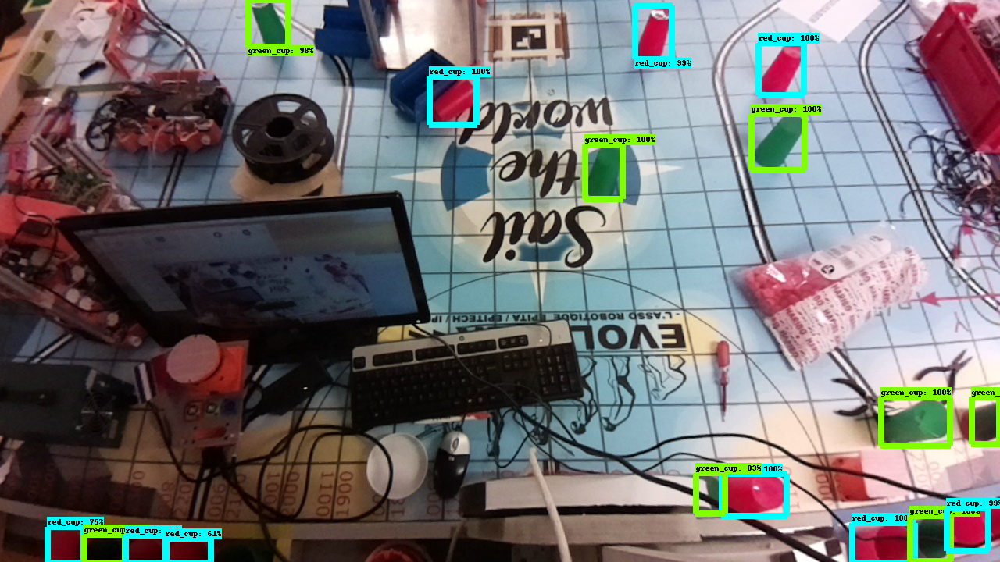

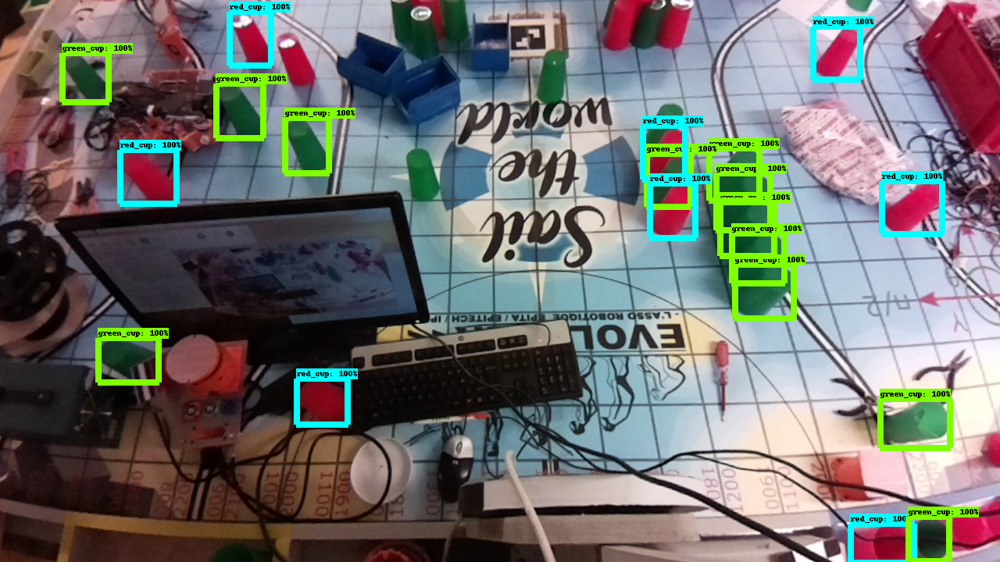

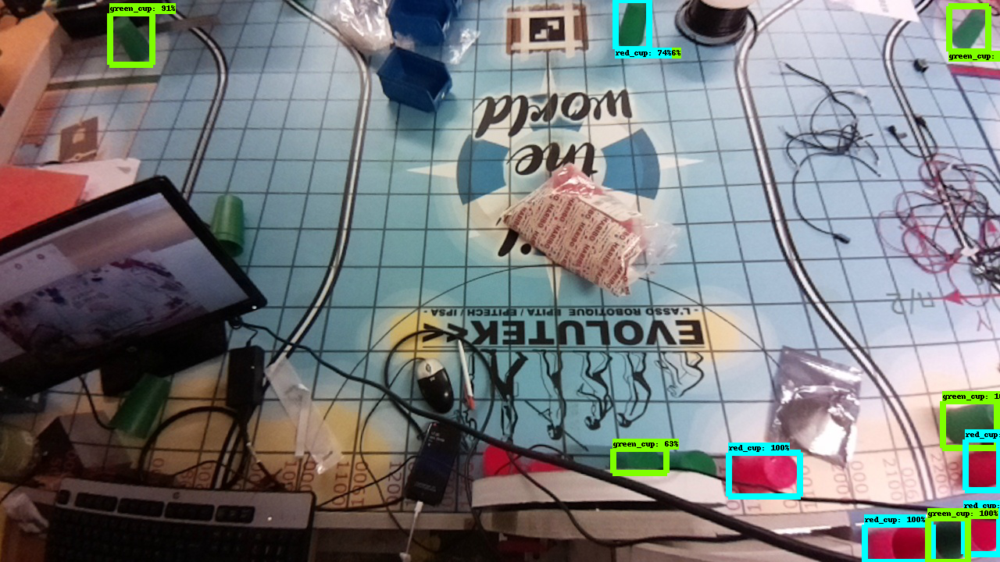

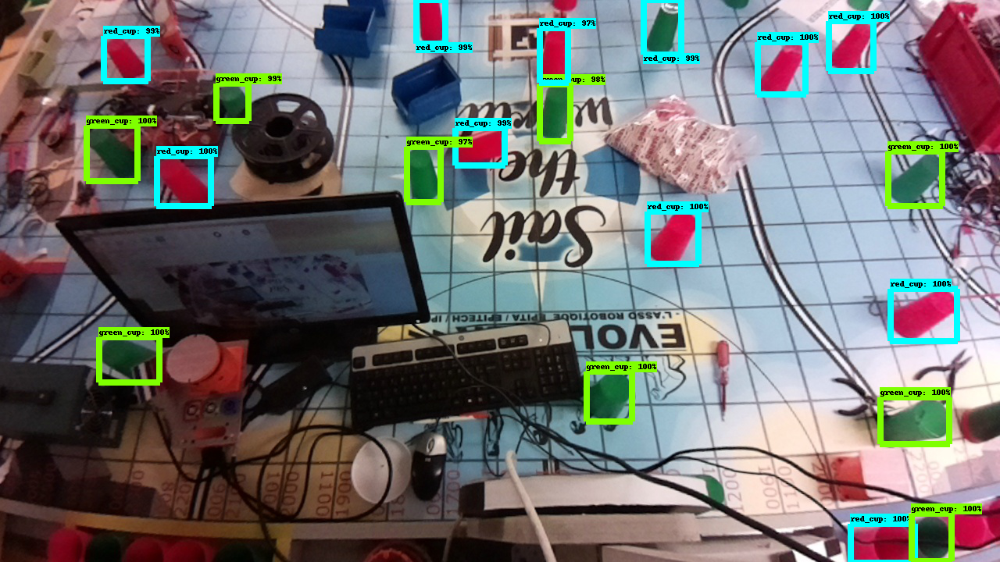

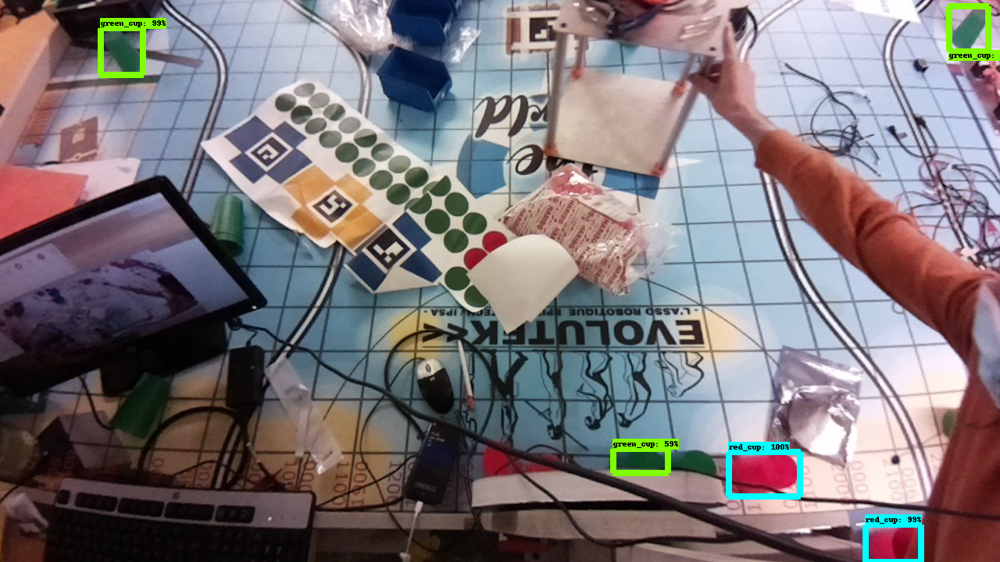

In [ ]:
# test_images_path = f'/content/working_files/{DATASET}/images/test/*.jpg'
test_images_path ='/content/drive/MyDrive/Evolutek_CV/dataset_06062021/images/test/*.jpg'
for image_path in glob.glob(test_images_path):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))